In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import plotly.graph_objs as go # plotly
#import chart_studio.plotly as py
import plotly.express as px
import plotly.offline as pyo

import warnings
warnings.filterwarnings('ignore')

import statistics
from statistics import median, median_grouped, median_high,median_low

from scipy.stats import skew, norm

#machinelearning
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, f1_score, make_scorer
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import StandardScaler

from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
import xgboost as xgb


In [2]:
train = pd.read_csv('train.csv')
test =pd.read_csv('test.csv')

In [3]:
stay_column = train['Stay']

In [4]:
train.Stay.unique().tolist()

['0-10',
 '41-50',
 '31-40',
 '11-20',
 '51-60',
 '21-30',
 '71-80',
 'More than 100 Days',
 '81-90',
 '61-70',
 '91-100']

In [5]:
stay_column.head()

0     0-10
1    41-50
2    31-40
3    41-50
4    41-50
Name: Stay, dtype: object

In [6]:
train

,case_id,Hospital_code,Hospital_type_code,City_Code_Hospital,Hospital_region_code,Available Extra Rooms in Hospital,Department,Ward_Type,Ward_Facility_Code,Bed Grade,patientid,City_Code_Patient,Type of Admission,Severity of Illness,Visitors with Patient,Age,Admission_Deposit,Stay
0,1,8,c,3,Z,3,radiotherapy,R,F,2.0,31397,7.0,Emergency,Extreme,2,51-60,4911.0,0-10
1,2,2,c,5,Z,2,radiotherapy,S,F,2.0,31397,7.0,Trauma,Extreme,2,51-60,5954.0,41-50
2,3,10,e,1,X,2,anesthesia,S,E,2.0,31397,7.0,Trauma,Extreme,2,51-60,4745.0,31-40
3,4,26,b,2,Y,2,radiotherapy,R,D,2.0,31397,7.0,Trauma,Extreme,2,51-60,7272.0,41-50
4,5,26,b,2,Y,2,radiotherapy,S,D,2.0,31397,7.0,Trauma,Extreme,2,51-60,5558.0,41-50
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
318433,318434,6,a,6,X,3,radiotherapy,Q,F,4.0,86499,23.0,Emergency,Moderate,3,41-50,4144.0,11-20
318434,318435,24,a,1,X,2,anesthesia,Q,E,4.0,325,8.0,Urgent,Moderate,4,81-90,6699.0,31-40
318435,318436,7,a,4,X,3,gynecology,R,F,4.0,125235,10.0,Emergency,Minor,3,71-80,4235.0,11-20
318436,318437,11,b,2,Y,3,anesthesia,Q,D,3.0,91081,8.0,Trauma,Minor,5,11-20,3761.0,11-20


In [8]:
train.describe()

,case_id,Hospital_code,City_Code_Hospital,Available Extra Rooms in Hospital,Bed Grade,patientid,City_Code_Patient,Visitors with Patient,Admission_Deposit
count,318438.000000,318438.000000,318438.000000,318438.000000,318325.000000,318438.000000,313906.000000,318438.000000,318438.000000
mean,159219.500000,18.318841,4.771717,3.197627,2.625807,65747.579472,7.251859,3.284099,4880.749392
std,91925.276847,8.633755,3.102535,1.168171,0.873146,37979.936440,4.745266,1.764061,1086.776254
min,1.000000,1.000000,1.000000,0.000000,1.000000,1.000000,1.000000,0.000000,1800.000000
25%,79610.250000,11.000000,2.000000,2.000000,2.000000,32847.000000,4.000000,2.000000,4186.000000
50%,159219.500000,19.000000,5.000000,3.000000,3.000000,65724.500000,8.000000,3.000000,4741.000000
75%,238828.750000,26.000000,7.000000,4.000000,3.000000,98470.000000,8.000000,4.000000,5409.000000
max,318438.000000,32.000000,13.000000,24.000000,4.000000,131624.000000,38.000000,32.000000,11008.000000


In [9]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 318438 entries, 0 to 318437
Data columns (total 18 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   case_id                            318438 non-null  int64  
 1   Hospital_code                      318438 non-null  int64  
 2   Hospital_type_code                 318438 non-null  object 
 3   City_Code_Hospital                 318438 non-null  int64  
 4   Hospital_region_code               318438 non-null  object 
 5   Available Extra Rooms in Hospital  318438 non-null  int64  
 6   Department                         318438 non-null  object 
 7   Ward_Type                          318438 non-null  object 
 8   Ward_Facility_Code                 318438 non-null  object 
 9   Bed Grade                          318325 non-null  float64
 10  patientid                          318438 non-null  int64  
 11  City_Code_Patient                  3139

In [11]:
train.nunique()

case_id                              318438
Hospital_code                            32
Hospital_type_code                        7
City_Code_Hospital                       11
Hospital_region_code                      3
Available Extra Rooms in Hospital        18
Department                                5
Ward_Type                                 6
Ward_Facility_Code                        6
Bed Grade                                 4
patientid                             92017
City_Code_Patient                        37
Type of Admission                         3
Severity of Illness                       3
Visitors with Patient                    28
Age                                      10
Admission_Deposit                      7300
Stay                                     11
dtype: int64

In [13]:
# CHECKING MISSING / NULL VALUES 

In [14]:
train.isnull().sum()

case_id                                 0
Hospital_code                           0
Hospital_type_code                      0
City_Code_Hospital                      0
Hospital_region_code                    0
Available Extra Rooms in Hospital       0
Department                              0
Ward_Type                               0
Ward_Facility_Code                      0
Bed Grade                             113
patientid                               0
City_Code_Patient                    4532
Type of Admission                       0
Severity of Illness                     0
Visitors with Patient                   0
Age                                     0
Admission_Deposit                       0
Stay                                    0
dtype: int64

In [15]:
train.isnull().sum()/len(train)*100

case_id                              0.000000
Hospital_code                        0.000000
Hospital_type_code                   0.000000
City_Code_Hospital                   0.000000
Hospital_region_code                 0.000000
Available Extra Rooms in Hospital    0.000000
Department                           0.000000
Ward_Type                            0.000000
Ward_Facility_Code                   0.000000
Bed Grade                            0.035486
patientid                            0.000000
City_Code_Patient                    1.423197
Type of Admission                    0.000000
Severity of Illness                  0.000000
Visitors with Patient                0.000000
Age                                  0.000000
Admission_Deposit                    0.000000
Stay                                 0.000000
dtype: float64

In [17]:
# IMPUTING BED GRADE & CITY_CODE_PATIENT WITH ATTRIBUTES 

# EDA

<Figure size 5040x2160 with 0 Axes>

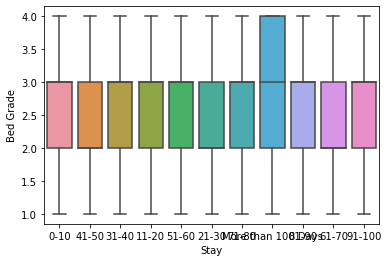

<Figure size 5040x2160 with 0 Axes>

In [18]:
sns.boxplot(x='Stay' , y ='Bed Grade',data = train)
plt.figure(figsize=(70,30))

In [19]:
stay=train.groupby(['Stay']).count().reset_index()

fig=px.pie(stay,
           values='case_id',
           names='Stay',
           labels={'case_id':'Count'},
           hover_data=['Stay'],
           title="Count of Stay",
           hole=0.23)
fig.show()

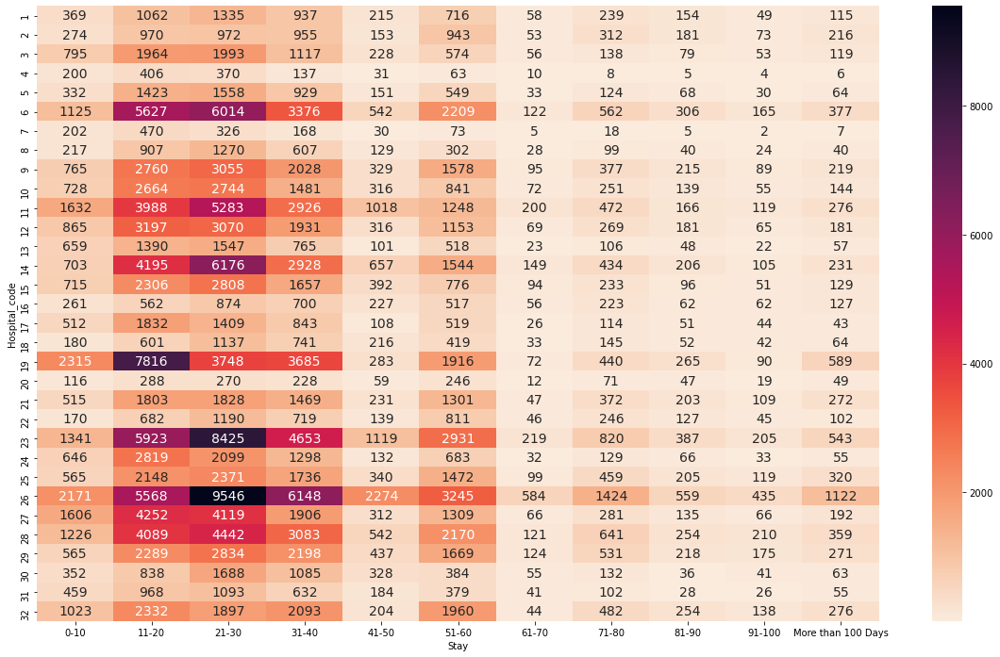

In [20]:
# pivot table with color
hc_stay=train.pivot_table(index=['Hospital_code'],
                          columns='Stay',
                          aggfunc='size')

f,ax=plt.subplots(figsize=(20,12))
sns.heatmap(hc_stay,
            cmap='rocket_r',
            annot=True,
            annot_kws={'size':14},
            fmt='d');


# We can see there are certain Hospital codes in which the no. of patients are significantly high, such as 26,23,19,14,11 and 6 for the Stay of 11-20,21-30 and 31-40 days.
#We will later merge them in bins according to their count.

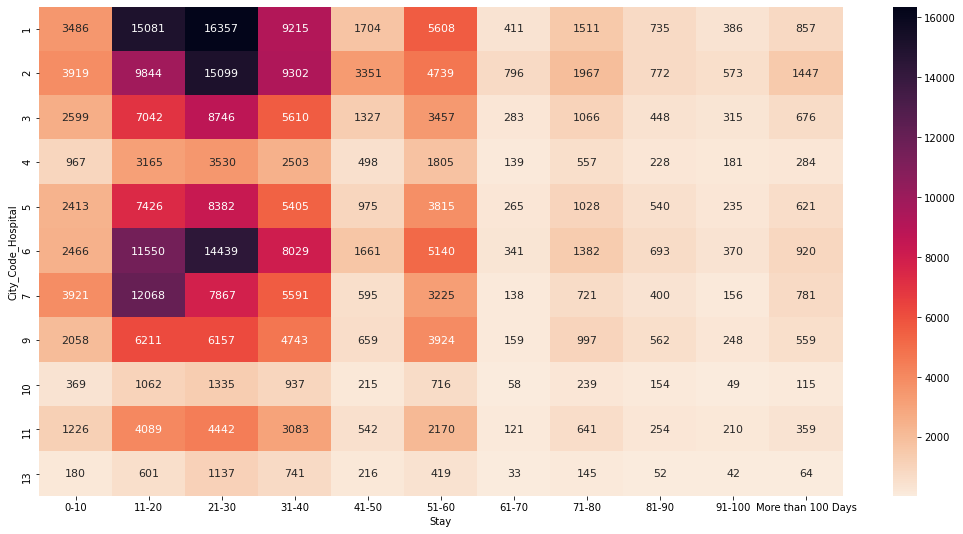

In [21]:
# pivot table
cch_stay=train.pivot_table(index=['City_Code_Hospital'],
                           columns='Stay',
                           aggfunc='size')

f,ax=plt.subplots(figsize=(18,9))
sns.heatmap(cch_stay,
            cmap='rocket_r',
            annot=True,
            annot_kws={'size':11},
            fmt='d');

We can see there are certain City Code Hospitals in which the no. of patients are significantly high, such as 1,2,6,7,3 and 5 for the Stay of 11-20,21-30,31-40 and 51-60 days.
We will later merge them in bins according to their count.

In [22]:
# grouped bar plot
bg_stay=train.groupby(['Stay','Bed Grade']).count().reset_index()
bg_stay['Bed Grade']=bg_stay['Bed Grade'].astype('str')

fig=px.bar(bg_stay,
           x='Stay',
           y='case_id',
           labels={'case_id':'Count'},
           title='Stay Bed Grade wise',
           color='Bed Grade',
           text='case_id',
           barmode='group')

fig.update_layout(xaxis_title="Stay",
                  yaxis_title="Count")
fig.update_traces(texttemplate='%{text:.2s}',
                  textposition='outside')
fig.show()

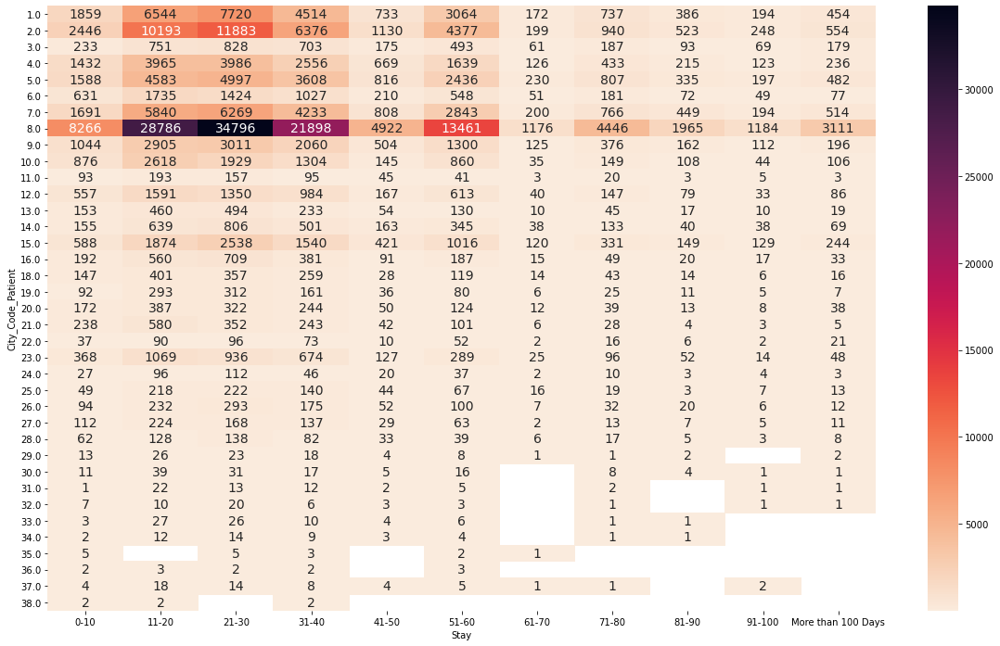

In [23]:
# pivot table with color
ccp_stay=train.pivot_table(index=['City_Code_Patient'],
                           columns='Stay',
                           aggfunc='size')

f,ax=plt.subplots(figsize=(20,12))
sns.heatmap(ccp_stay,
            cmap='rocket_r',
            annot=True,
            annot_kws={'size':14},
            fmt='g');

We can see there are certain City Code Patient in which the no. of patients are significantly high, such as 8.0,2.0,1.0,7.0,5.0 and 4.0 for the Stay of 11-20,21-30,31-40 and 51-60 days.
We will later merge them in bins according to their count.
There are some missing values in this attribute.

In [24]:
# grouped bar plot
toa_stay=train.groupby(['Stay','Type of Admission']).count().reset_index()

fig=px.bar(toa_stay,
           x='Stay',
           y='case_id',
           labels={'case_id':'Count'},
           title='Stay Type of Admission wise',
           color='Type of Admission',
           text='case_id',
           barmode='group')

fig.update_layout(xaxis_title="Stay",
                  yaxis_title="Count")
fig.update_traces(texttemplate='%{text:.2s}',
                  textposition='outside')
fig.show()

In [25]:
# grouped bar plot
soi_stay=train.groupby(['Stay','Severity of Illness']).count().reset_index()

fig=px.bar(soi_stay,
           x='Stay',
           y='case_id',
           labels={'case_id':'Count'},
           title='Stay Severity of Illness wise',
           color='Severity of Illness',
           text='case_id',
           barmode='group')

fig.update_layout(xaxis_title="Stay",
                  yaxis_title="Count")
fig.update_traces(texttemplate='%{text:.2s}',
                  textposition='outside')
fig.show()

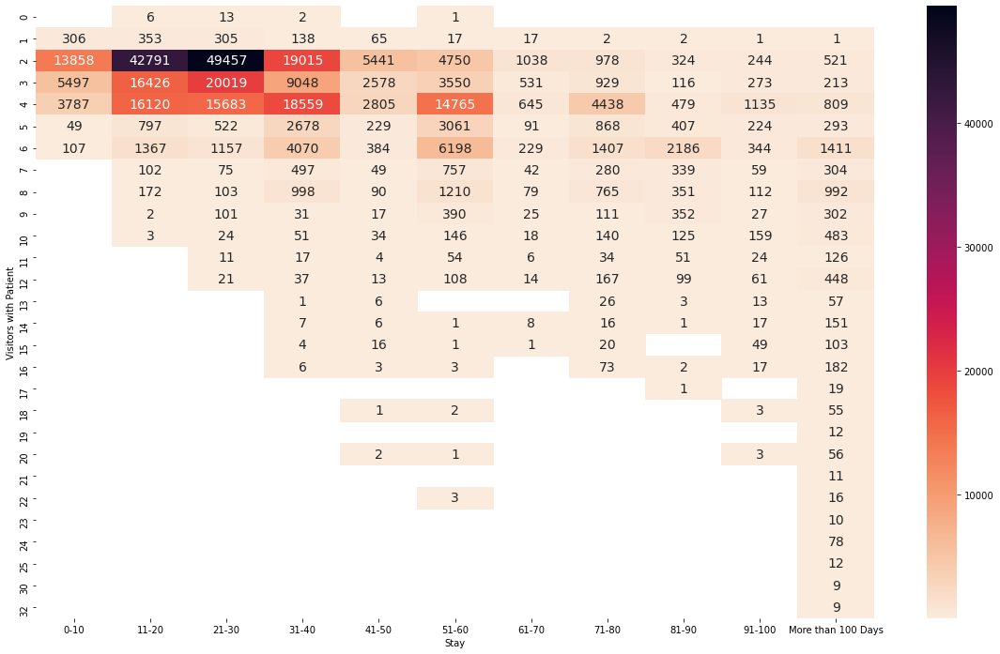

In [26]:
# pivot table with color
vwp_stay=train.pivot_table(index=['Visitors with Patient'],
                           columns='Stay',
                           aggfunc='size')

f,ax=plt.subplots(figsize=(20,12))
sns.heatmap(vwp_stay,
            cmap='rocket_r',
            annot=True,
            annot_kws={'size':14},
            fmt='g');

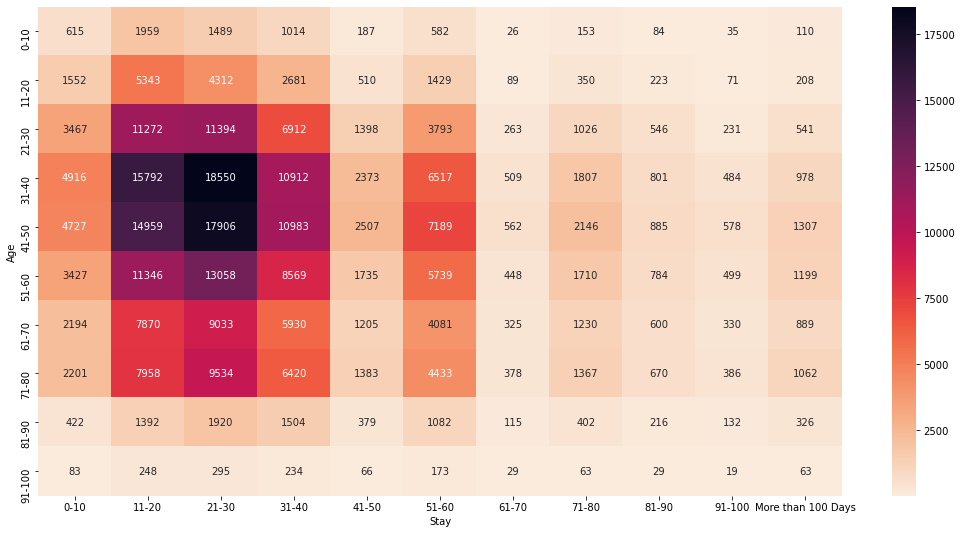

In [27]:
# pivot table with color
age_stay=train.pivot_table(index=['Age'],
                           columns='Stay',
                           aggfunc='size')

f,ax=plt.subplots(figsize=(18,9))
sns.heatmap(age_stay,
            cmap='rocket_r',
            annot=True,
            annot_kws={'size':10},
            fmt='g');

In [28]:
fig=px.box(train,
           y='Admission_Deposit',
           x='Stay',
           title='Distribution of Admission Deposit Stay wise',
           color='Stay',
           points=False)
fig.show()

Imputations

Median

In [29]:
statistics.median(train['City_Code_Patient'])

8.0

In [30]:
statistics.median(test['City_Code_Patient'])

8.0

In [31]:
train['City_Code_Patient'].fillna(8.0,inplace=True)
test['City_Code_Patient'].fillna(8.0,inplace=True)

Mode

In [32]:
statistics.mode(train['Bed Grade'])

2.0

In [33]:
statistics.mode(test['Bed Grade'])

2.0

Filling missing values with imputations

In [34]:
train['Bed Grade'].fillna(2.0,inplace=True)
test['Bed Grade'].fillna(2.0,inplace=True)

In [35]:
# train
map_hc_tr={26:1,23:1,19:1,6:1,11:1,28:1,14:1,27:1,
           12:2,9:2,29:2,32:2,25:2,10:2,15:2,21:2,24:2,3:2,
           17:3,30:3,1:3,13:3,5:3,2:3,31:3,22:3,8:3,18:3,16:3,
           7:4,20:4,4:4}
for dataset in train:
    train['Hospital_code_bins']=train['Hospital_code'].map(map_hc_tr)

In [36]:
# testset given in the question
map_hc_te={26:1,23:1,19:1,6:1,11:1,28:1,14:1,27:1,
           12:2,9:2,29:2,32:2,25:2,10:2,15:2,21:2,24:2,3:2,
           17:3,30:3,1:3,13:3,5:3,2:3,31:3,22:3,8:3,18:3,16:3,
           7:4,20:4,4:4}
for dataset in test:
    test['Hospital_code_bins']=test['Hospital_code'].map(map_hc_te)

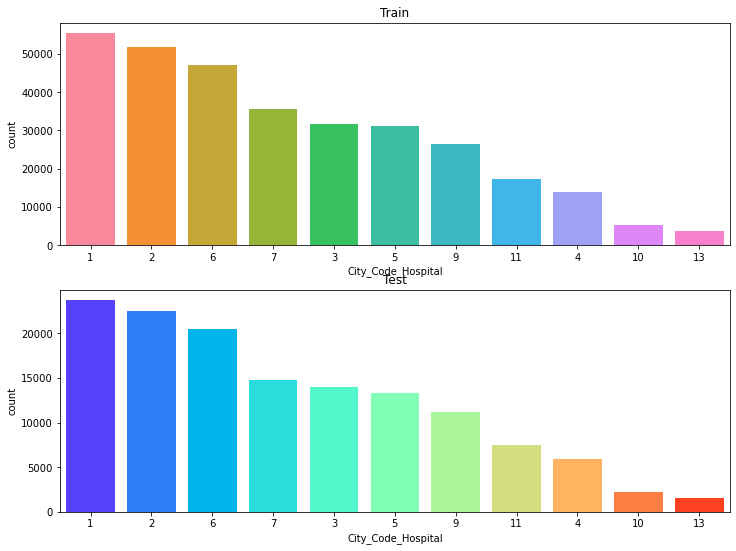

In [37]:
fig,(axis1,axis2)=plt.subplots(2,1,figsize=(12,9))

sns.countplot(data=train,
              x='City_Code_Hospital',
              saturation=1,
              ax=axis1,
              order=train['City_Code_Hospital'].value_counts().index);
axis1.set_title("Train",size=12);

sns.countplot(data=test,
              x='City_Code_Hospital',
              saturation=1,
              ax=axis2,
              palette='rainbow',
              order=test['City_Code_Hospital'].value_counts().index);
axis2.set_title("Test",size=12);

In [38]:
# train
map_cch_tr={1:1,2:1,6:1,
            7:2,3:2,5:2,9:2,
            13:3,10:3,4:3,11:3}
for dataset in train:
    train['City_Code_Hospital_bins']=train['City_Code_Hospital'].map(map_cch_tr)

In [39]:
# test
map_cch_te={1:1,2:1,6:1,
            7:2,3:2,5:2,9:2,
            13:3,10:3,4:3,11:3}
for dataset in test:
    test['City_Code_Hospital_bins']=test['City_Code_Hospital'].map(map_cch_te)

Dummification

In [40]:
# train
train_encoded=pd.get_dummies(train,
                     columns=['Hospital_type_code','Hospital_region_code','Department','Ward_Type','Ward_Facility_Code',
                              'Bed Grade','Type of Admission','Severity of Illness','Age','Hospital_code_bins',
                              'City_Code_Hospital_bins'],
                     drop_first=True,
                     prefix=['htc','hrc','depart','wt','wfc','bg','toa','soi','age','hcb','cchb'])

In [41]:
test_encoded=pd.get_dummies(test,
                     columns=['Hospital_type_code','Hospital_region_code','Department','Ward_Type','Ward_Facility_Code',
                              'Bed Grade','Type of Admission','Severity of Illness','Age','Hospital_code_bins',
                              'City_Code_Hospital_bins'],
                     drop_first=True,
                     prefix=['htc','hrc','depart','wt','wfc','bg','toa','soi','age','hcb','cchb'])

# Assigning Independent and Dependent Variables¶

In [42]:
X=train_encoded.drop(columns=['case_id','Hospital_code','City_Code_Hospital','patientid','Stay'])
y=train_encoded['Stay']

test_for_predictions=test_encoded.drop(columns=['case_id','Hospital_code','City_Code_Hospital','patientid'])

Train - Validation Split

In [43]:
X_train,X_val,y_train,y_val=train_test_split(X,y,stratify=y,test_size=0.30,random_state=44)

In [44]:
X_train.shape

(222906, 47)

In [45]:
y_train.value_counts(normalize=True)*100

21-30                 27.475259
11-20                 24.538146
31-40                 17.321651
51-60                 10.996564
0-10                   7.412542
41-50                  3.687653
71-80                  3.220191
More than 100 Days     2.098642
81-90                  1.519475
91-100                 0.868079
61-70                  0.861798
Name: Stay, dtype: float64

In [46]:
y_val.value_counts(normalize=True)*100

21-30                 27.474563
11-20                 24.538375
31-40                 17.321944
51-60                 10.997362
0-10                   7.412176
41-50                  3.687770
71-80                  3.219864
More than 100 Days     2.098773
81-90                  1.518863
91-100                 0.868819
61-70                  0.861491
Name: Stay, dtype: float64

Machine Learning 

# Logistic Regression

In [47]:
LR=LogisticRegression()
LR.fit(X_train,y_train)

y_pred_LR_tr=LR.predict(X_train)
y_pred_LR_val=LR.predict(X_val)

ac_lr_tr=accuracy_score(y_train,y_pred_LR_tr)
ac_lr_val=accuracy_score(y_val,y_pred_LR_val)

print('Train Accuracy Score')
print(ac_lr_tr*100)
print('Validation Accuracy Score')
print(ac_lr_val*100)


Train Accuracy Score
33.93627807237131
Validation Accuracy Score
33.64108361596114


In [48]:
print(classification_report(y_train,y_pred_LR_tr))
print(classification_report(y_val,y_pred_LR_val))

                    precision    recall  f1-score   support

              0-10       0.15      0.03      0.05     16523
             11-20       0.36      0.23      0.28     54697
             21-30       0.38      0.74      0.50     61244
             31-40       0.26      0.29      0.27     38611
             41-50       0.00      0.00      0.00      8220
             51-60       0.29      0.25      0.27     24512
             61-70       0.00      0.00      0.00      1921
             71-80       0.00      0.00      0.00      7178
             81-90       0.00      0.00      0.00      3387
            91-100       0.00      0.00      0.00      1935
More than 100 Days       0.00      0.00      0.00      4678

          accuracy                           0.34    222906
         macro avg       0.13      0.14      0.12    222906
      weighted avg       0.28      0.34      0.29    222906

                    precision    recall  f1-score   support

              0-10       0.14      0

# Decision Tree

In [49]:
DT=DecisionTreeClassifier()
DT.fit(X_train,y_train)

y_pred_DT_tr=DT.predict(X_train)
y_pred_DT_val=DT.predict(X_val)

ac_dt_tr=accuracy_score(y_train,y_pred_DT_tr)
ac_dt_val=accuracy_score(y_val,y_pred_DT_val)

print('Train Accuracy Score')
print(ac_dt_tr*100)
print('Validation Accuracy Score')
print(ac_dt_val*100)

Train Accuracy Score
99.95603527944515
Validation Accuracy Score
29.48226772181049


In [50]:
DT_1=DecisionTreeClassifier(max_depth=4)
DT_1.fit(X_train,y_train)

y_pred_DT_tr=DT_1.predict(X_train)
y_pred_DT_val=DT_1.predict(X_val)

ac_dt_tr=accuracy_score(y_train,y_pred_DT_tr)
ac_dt_val=accuracy_score(y_val,y_pred_DT_val)

print('Train Accuracy Score')
print(ac_dt_tr*100)
print('Validation Accuracy Score')
print(ac_dt_val*100)

Train Accuracy Score
37.240810027545244
Validation Accuracy Score
36.82954402713227


In [51]:
print(classification_report(y_train,y_pred_DT_tr))
print(classification_report(y_val,y_pred_DT_val))

                    precision    recall  f1-score   support

              0-10       0.00      0.00      0.00     16523
             11-20       0.37      0.44      0.41     54697
             21-30       0.39      0.65      0.49     61244
             31-40       0.34      0.06      0.10     38611
             41-50       0.00      0.00      0.00      8220
             51-60       0.34      0.58      0.43     24512
             61-70       0.00      0.00      0.00      1921
             71-80       0.00      0.00      0.00      7178
             81-90       0.00      0.00      0.00      3387
            91-100       0.00      0.00      0.00      1935
More than 100 Days       0.39      0.49      0.43      4678

          accuracy                           0.37    222906
         macro avg       0.17      0.20      0.17    222906
      weighted avg       0.30      0.37      0.31    222906

                    precision    recall  f1-score   support

              0-10       0.00      0

# Random Forest

In [52]:
RF=RandomForestClassifier(max_depth=13,n_estimators=200,criterion='entropy')
RF.fit(X_train,y_train)

y_pred_RF_tr=RF.predict(X_train)
y_pred_RF_val=RF.predict(X_val)

ac_rf_tr=accuracy_score(y_train,y_pred_RF_tr)
ac_rf_val=accuracy_score(y_val,y_pred_RF_val)

print('Train Accuracy Score')
print(ac_rf_tr*100)
print('Validation Accuracy Score')
print(ac_rf_val*100)

Train Accuracy Score
48.53121943778992
Validation Accuracy Score
41.15898337729766


In [53]:
print(classification_report(y_train,y_pred_RF_tr))
print(classification_report(y_val,y_pred_RF_val))

                    precision    recall  f1-score   support

              0-10       0.75      0.11      0.19     16523
             11-20       0.48      0.57      0.52     54697
             21-30       0.46      0.74      0.56     61244
             31-40       0.56      0.30      0.39     38611
             41-50       1.00      0.01      0.03      8220
             51-60       0.48      0.61      0.54     24512
             61-70       1.00      0.02      0.04      1921
             71-80       1.00      0.06      0.12      7178
             81-90       0.99      0.13      0.24      3387
            91-100       1.00      0.04      0.08      1935
More than 100 Days       0.78      0.46      0.58      4678

          accuracy                           0.49    222906
         macro avg       0.77      0.28      0.30    222906
      weighted avg       0.57      0.49      0.45    222906

                    precision    recall  f1-score   support

              0-10       0.49      0

# Gradient Boost

In [55]:
GB=GradientBoostingClassifier()
GB.fit(X_train,y_train)

y_pred_GB_tr=GB.predict(X_train)
y_pred_GB_val=GB.predict(X_val)

ac_gb_tr=accuracy_score(y_train,y_pred_GB_tr)
ac_gb_val=accuracy_score(y_val,y_pred_GB_val)

print('Train Accuracy Score')
print(ac_gb_tr*100)
print('Validation Accuracy Score')
print(ac_gb_val*100)

Train Accuracy Score
41.60632733080312
Validation Accuracy Score
40.885776493740316


In [56]:
print(classification_report(y_train,y_pred_GB_tr))
print(classification_report(y_val,y_pred_GB_val))

                    precision    recall  f1-score   support

              0-10       0.42      0.11      0.18     16523
             11-20       0.42      0.50      0.45     54697
             21-30       0.42      0.67      0.52     61244
             31-40       0.41      0.17      0.24     38611
             41-50       0.93      0.00      0.01      8220
             51-60       0.39      0.54      0.45     24512
             61-70       0.86      0.02      0.03      1921
             71-80       0.42      0.01      0.02      7178
             81-90       0.36      0.25      0.30      3387
            91-100       0.62      0.03      0.06      1935
More than 100 Days       0.53      0.42      0.47      4678

          accuracy                           0.42    222906
         macro avg       0.53      0.25      0.25    222906
      weighted avg       0.44      0.42      0.37    222906

                    precision    recall  f1-score   support

              0-10       0.41      0